In [1]:
#!unzip C

In [2]:
!head CDNOW_master.txt

In [3]:
!cat read_me_CDNOW_master.txt

In [4]:
import pandas as pd

In [5]:
df=pd.read_csv("CDNOW_master.txt",header=None)

In [6]:
df.head()

,0
0,00001 19970101 1 11.77
1,00002 19970112 1 12.00
2,00002 19970112 5 77.00
3,00003 19970102 2 20.76
4,00003 19970330 2 20.76


In [7]:
f=open("CDNOW_master.txt")

In [8]:
contenido = f.read()

In [9]:
lista_lineas=contenido.split("\n")

In [10]:
lista_lineas[:5]

[' 00001 19970101  1   11.77',
 ' 00002 19970112  1   12.00',
 ' 00002 19970112  5   77.00',
 ' 00003 19970102  2   20.76',
 ' 00003 19970330  2   20.76']

In [11]:
primera_linea=lista_lineas[0]

In [12]:
primera_linea.split()

['00001', '19970101', '1', '11.77']

In [13]:
elementos = list(map(lambda e: e.split(),lista_lineas))

In [14]:
type(elementos)

list

In [15]:
elementos[:5]

[['00001', '19970101', '1', '11.77'],
 ['00002', '19970112', '1', '12.00'],
 ['00002', '19970112', '5', '77.00'],
 ['00003', '19970102', '2', '20.76'],
 ['00003', '19970330', '2', '20.76']]

In [16]:
df=pd.DataFrame(elementos)

In [17]:
df.head()

,0,1,2,3
0,00001,19970101,1,11.77
1,00002,19970112,1,12.00
2,00002,19970112,5,77.00
3,00003,19970102,2,20.76
4,00003,19970330,2,20.76


In [18]:
df.columns=["customerID","date","quantity","money"]

In [19]:
df.head()

,customerID,date,quantity,money
0,00001,19970101,1,11.77
1,00002,19970112,1,12.00
2,00002,19970112,5,77.00
3,00003,19970102,2,20.76
4,00003,19970330,2,20.76


In [20]:
#df=pd.read_csv("CDNOW_master.txt",header=None)
#df[0].iloc[:100].str.split().apply(lambda e: pd.Series(e))

In [21]:
df.describe()

,customerID,date,quantity,money
count,69659,69659,69659,69659
unique,23570,546,45,8209
top,14048,19970224,1,11.77
freq,217,504,31454,2325


In [22]:
df.dtypes

customerID    object
date          object
quantity      object
money         object
dtype: object

In [23]:
df.head()

,customerID,date,quantity,money
0,00001,19970101,1,11.77
1,00002,19970112,1,12.00
2,00002,19970112,5,77.00
3,00003,19970102,2,20.76
4,00003,19970330,2,20.76


In [24]:
from datetime import datetime
datetime.strptime("","")

datetime.datetime(1900, 1, 1, 0, 0)

In [25]:
df["date"]=pd.to_datetime(df["date"],format="%Y%m%d")

In [26]:
df.dtypes

customerID            object
date          datetime64[ns]
quantity              object
money                 object
dtype: object

In [27]:
df["quantity"]=df["quantity"].astype(float)

In [28]:
df.dtypes

customerID            object
date          datetime64[ns]
quantity             float64
money                 object
dtype: object

In [29]:
df["money"]=df["money"].astype(float)

In [30]:
df.dtypes

customerID            object
date          datetime64[ns]
quantity             float64
money                float64
dtype: object

In [31]:
# Adquisicion y limpieza del dato
lista_lineas=open("CDNOW_master.txt").read().split("\n")
elementos = list(map(lambda e: e.split(),lista_lineas))
df=pd.DataFrame(elementos)
df=df.dropna()
df.columns=["customerID","date","quantity","money"]

In [32]:
#Verificando si hay lineas vacias en mi dataframe
df[df.isnull()["quantity"]]

,customerID,date,quantity,money


In [33]:
df.head()

,customerID,date,quantity,money
0,00001,19970101,1,11.77
1,00002,19970112,1,12.00
2,00002,19970112,5,77.00
3,00003,19970102,2,20.76
4,00003,19970330,2,20.76


In [34]:
# Parseo de los datos
df["date"]=pd.to_datetime(df["date"],format="%Y%m%d")
df["quantity"]=df["quantity"].astype(float)
df["money"]=df["money"].astype(float)

In [35]:
df.head()

,customerID,date,quantity,money
0,00001,1997-01-01,1.0,11.77
1,00002,1997-01-12,1.0,12.00
2,00002,1997-01-12,5.0,77.00
3,00003,1997-01-02,2.0,20.76
4,00003,1997-03-30,2.0,20.76


In [36]:
per_date=df.groupby("date").sum()

In [37]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


/Users/sebastien.perez/anaconda3/lib/python3.6/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['f', 'datetime']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


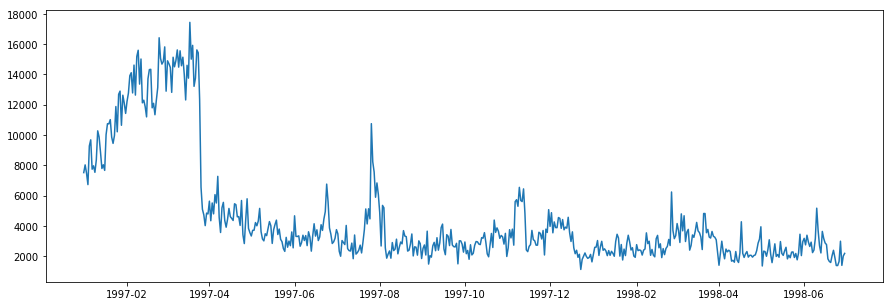

In [38]:
plt.figure(figsize=(15,5))
plt.plot(per_date.index,per_date["money"]);

In [39]:
df[df["customerID"]=="00010"]

,customerID,date,quantity,money
39,00010,1997-01-21,3.0,39.31


In [40]:
all_cid = df["customerID"].unique()

In [41]:
all_cid

array(['00001', '00002', '00003', ..., '23568', '23569', '23570'],
      dtype=object)

In [42]:
from ipywidgets import interact

In [43]:
@interact(cid=all_cid[:100])
def show_cid(cid):
    return df[df["customerID"]==cid]

interactive(children=(Dropdown(description='cid', options=('00001', '00002', '00003', '00004', '00005', '00006…

In [44]:
cliente_89 = df[df["customerID"]=="00089"]

<Container object of 18 artists>

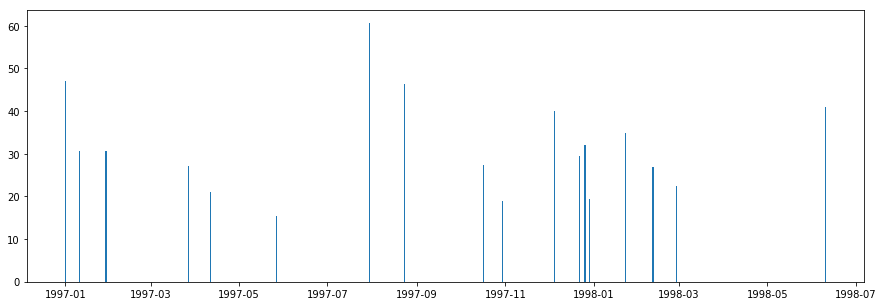

In [45]:
plt.figure(figsize=(15,5))
plt.bar(cliente_89["date"],cliente_89["money"])

In [46]:
import plotly.offline as py
import plotly.graph_objs as go

In [47]:
py.init_notebook_mode(connected=True)

In [48]:
py.iplot([go.Bar(x=cliente_89["date"],y=cliente_89["quantity"])])

In [49]:
@interact(cid=all_cid[:100])
def show_cid(cid):
    temp= df[df["customerID"]==cid]
    py.iplot([go.Bar(x=temp["date"],y=temp["quantity"])])

interactive(children=(Dropdown(description='cid', options=('00001', '00002', '00003', '00004', '00005', '00006…

In [50]:
df.to_csv("transacciones.csv",index=False)

In [51]:
cliente_89_calib=cliente_89[cliente_89["date"]<"1997-09-30"]

In [52]:
cliente_89_calib

,customerID,date,quantity,money
337,00089,1997-01-01,3.0,47.08
338,00089,1997-01-11,2.0,30.72
339,00089,1997-01-29,2.0,30.72
340,00089,1997-03-27,2.0,27.13
341,00089,1997-04-11,1.0,20.97
342,00089,1997-05-27,1.0,15.36
343,00089,1997-07-30,4.0,60.67
344,00089,1997-08-23,2.0,46.42


In [53]:
# Recency
from datetime import datetime

In [54]:
(datetime(1997,9,30)-cliente_89_calib["date"].max()).days

38

In [55]:
# Monetary
cliente_89_calib["money"].sum()

279.07

In [56]:
#Frequency
len(cliente_89_calib)

8

In [57]:
def process(df):
    recency =  (datetime(1997,9,30)-df["date"].max()).days
    frequency = len(df)
    monetary = df["money"].sum()
    
    return pd.Series([recency,frequency,monetary])

df_calib=df[df["date"]<"1997-09-30"].copy()
rfm = df_calib.groupby("customerID").apply(process)

In [58]:
rfm[rfm.index=="00089"]

,0,1,2
customerID,,,
00089,38.0,8.0,279.07


In [59]:
rfm.columns=["recency","frequency","monetary"]
rfm=rfm.reset_index()

In [60]:
rfm.head()

,customerID,recency,frequency,monetary
0,00001,272.0,1.0,11.77
1,00002,261.0,2.0,89.00
2,00003,181.0,3.0,61.06
3,00004,59.0,3.0,74.02
4,00005,15.0,8.0,261.21


In [61]:
np.percentile(rfm["recency"],50)

208.0

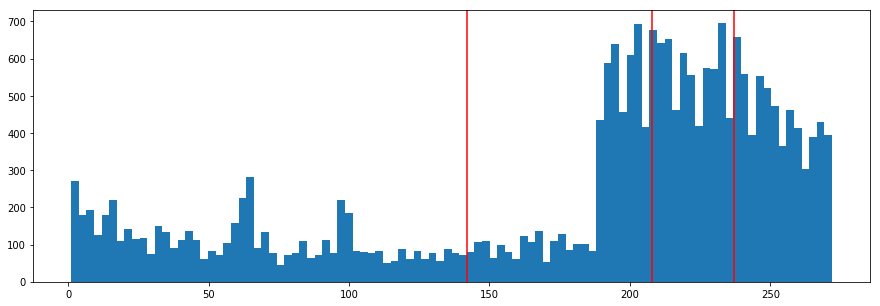

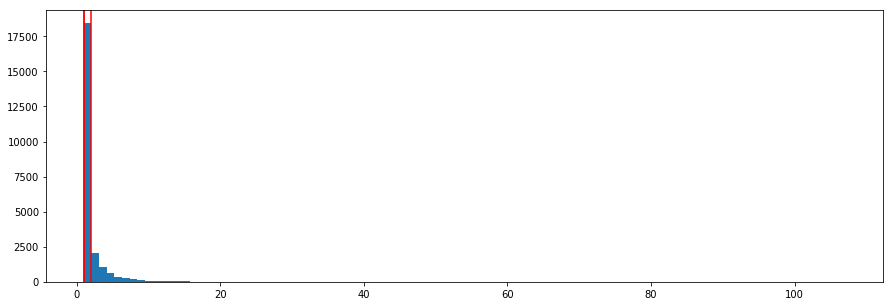

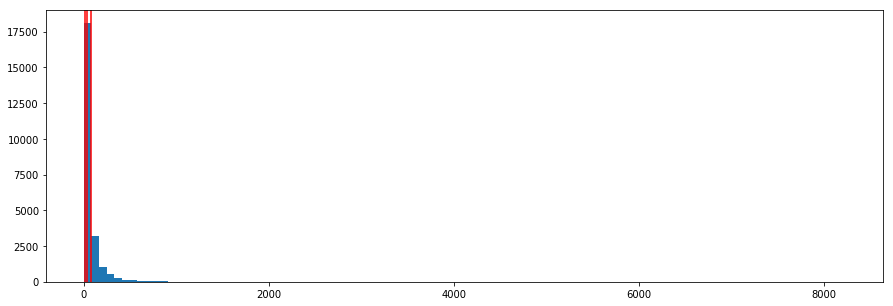

In [62]:
for col in ["recency","frequency","monetary"]:
    plt.figure(figsize=(15,5))
    plt.hist(rfm[col],bins=100)
    for p in [25,50,75]:
        plt.axvline(x=np.percentile(rfm[col],p),color="red")
    plt.show()

In [63]:
py.iplot([go.Scatter3d(x=rfm["recency"],y=rfm["frequency"],z=rfm["monetary"],mode="markers")])

In [64]:
from sklearn.cluster import KMeans

In [65]:
# Kmeans

In [66]:
X=rfm[["recency","frequency","monetary"]].values

In [67]:
X

array([[272.  ,   1.  ,  11.77],
       [261.  ,   2.  ,  89.  ],
       [181.  ,   3.  ,  61.06],
       ...,
       [161.  ,   3.  , 121.7 ],
       [189.  ,   1.  ,  25.74],
       [188.  ,   2.  ,  94.08]])

In [68]:
model = KMeans(n_clusters=5)

In [69]:
labels = model.fit_predict(X)

In [70]:
labels

array([0, 0, 0, ..., 3, 0, 0], dtype=int32)

In [71]:
len(labels)

23570

In [72]:
py.iplot([go.Scatter3d(x=rfm["recency"],
                       y=rfm["frequency"],
                       z=rfm["monetary"],
                       mode="markers",
                       marker={"color":labels})])

In [73]:
from sklearn.preprocessing import RobustScaler

In [74]:
rbs = RobustScaler()

In [75]:
X_scaled = rbs.fit_transform(X)

In [76]:
py.iplot([go.Scatter3d(x=X_scaled[:,0],
                       y=X_scaled[:,1],
                       z=X_scaled[:,2],
                       mode="markers")])

In [77]:
labels = model.fit_predict(X_scaled)

In [78]:
py.iplot([go.Scatter3d(x=X_scaled[:,0],
                       y=X_scaled[:,1],
                       z=X_scaled[:,2],
                       mode="markers",
                      marker={"color":labels})])

In [79]:
from scipy import stats 

In [80]:
rfm_o = rfm.copy()

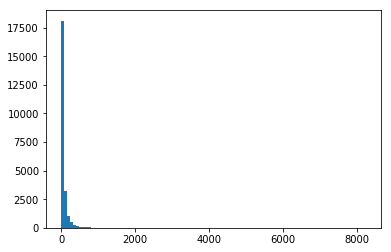

In [81]:
plt.hist(rfm_o["monetary"],bins=100);

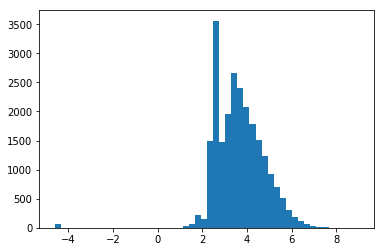

In [82]:
plt.hist(np.log(rfm_o["monetary"]+0.01),bins=50);

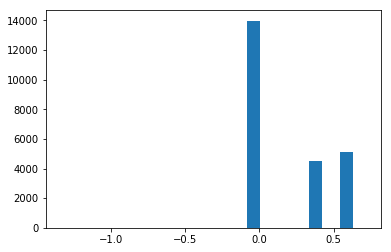

In [83]:
plt.hist(stats.boxcox(rfm["frequency"]+0.01));

In [84]:
rfm["frequency"]=stats.boxcox(rfm["frequency"]+0.01)[0]

In [85]:
rfm["monetary"]=stats.boxcox(rfm["monetary"]+0.01)[0]

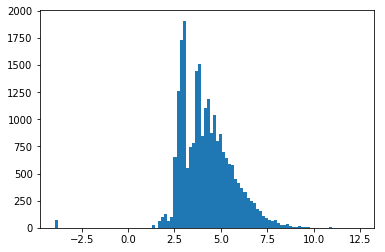

In [86]:
plt.hist(rfm["monetary"],bins=100);

In [87]:
X=rfm[["recency","frequency","monetary"]].values

In [88]:
py.iplot([go.Scatter3d(x=X[:,0],
                       y=X[:,1],
                       z=X[:,2],
                       mode="markers",
                      marker={"color":labels})])

In [89]:
rfm_o = rfm.copy()

In [90]:
#rfm["monetary"]=stats.boxcox(rfm["monetary"]+0.01)[0]
#rfm["frequency"]=stats.boxcox(rfm["frequency"]+0.01)[0]

In [91]:
X = rfm[["recency","frequency","monetary"]].values

In [92]:
rbs = RobustScaler()
X_scaled = rbs.fit_transform(X)

In [93]:
labels = model.fit_predict(X_scaled)

In [94]:
model = KMeans(n_clusters=5)
labels = model.fit_predict(X_scaled)
py.iplot([go.Scatter3d(x=rfm["recency"],
                       y=rfm["frequency"],
                       z=rfm["monetary"],
                       mode="markers",
                       marker={"color":labels})])

In [95]:
@interact(n=5)
def show_cluster(n):
    model = KMeans(n_clusters=n)
    labels = model.fit_predict(X_scaled)
    py.iplot([go.Scatter3d(x=rfm["recency"],
                       y=rfm["frequency"],
                       z=rfm["monetary"],
                       mode="markers",
                       marker={"color":labels})])

interactive(children=(IntSlider(value=5, description='n', max=15, min=-5), Output()), _dom_classes=('widget-in…

In [96]:
from sklearn.cluster import DBSCAN

In [97]:
model_2 = DBSCAN(eps=.2)

In [98]:
labels_2 = model_2.fit_predict(X_scaled)

In [99]:
@interact(n=5)
def show_cluster(n):
    model_2 = DBSCAN(eps=.1*n)
    labels_2 = model_2.fit_predict(X_scaled)
    py.iplot([go.Scatter3d(x=rfm["recency"],
                       y=rfm["frequency"],
                       z=rfm["monetary"],
                       mode="markers",
                       marker={"color":labels_2})])

interactive(children=(IntSlider(value=5, description='n', max=15, min=-5), Output()), _dom_classes=('widget-in…

In [100]:
model.score(X_scaled)

-5709.686222275843

In [101]:
def get_score(n):
    model = KMeans(n_clusters=n)
    labels = model.fit_predict(X_scaled)
    return -model.score(X_scaled)

In [102]:
scores = [get_score(i) for i in range(1,10)]

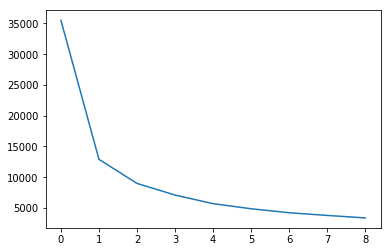

In [103]:
plt.plot(scores)

In [104]:
rfm_o.head()

,customerID,recency,frequency,monetary
0,00001,272.0,0.009883,2.686318
1,00002,261.0,0.450851,5.252897
2,00003,181.0,0.571144,4.747537
3,00004,59.0,0.571144,5.004073
4,00005,15.0,0.692136,6.770903


In [105]:
labels_2

array([0, 1, 2, ..., 2, 0, 1])

In [106]:
rfm_o["cluster"]=labels_2

In [107]:
rfm_o.head()

,customerID,recency,frequency,monetary,cluster
0,00001,272.0,0.009883,2.686318,0
1,00002,261.0,0.450851,5.252897,1
2,00003,181.0,0.571144,4.747537,2
3,00004,59.0,0.571144,5.004073,2
4,00005,15.0,0.692136,6.770903,2


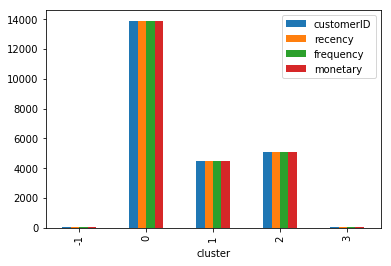

In [108]:
rfm_o.groupby("cluster").count().plot(kind="bar")

In [109]:
rfm_2 = rfm_o[rfm_o["cluster"]==3].copy()

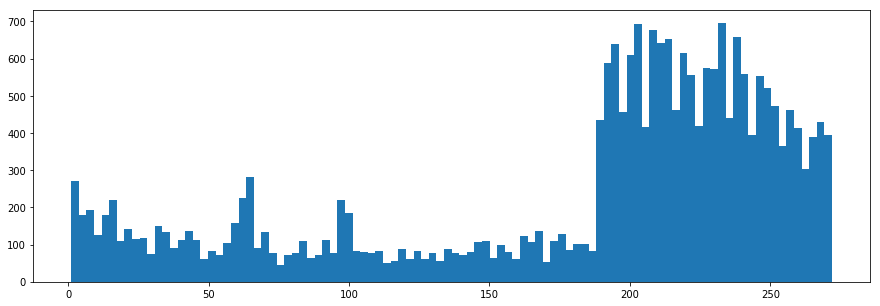

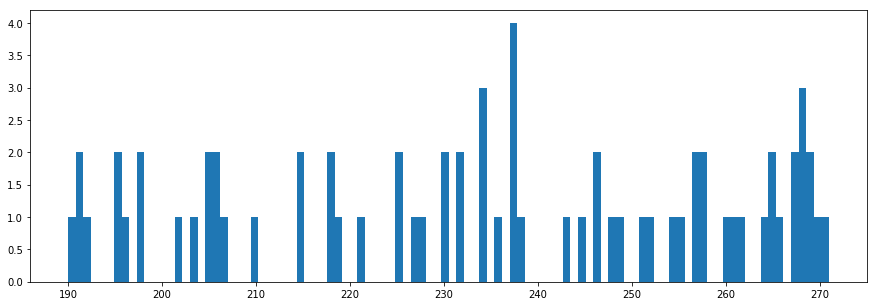

In [110]:
plt.figure(figsize=(15,5))
plt.hist(rfm_o["recency"],bins=100)
plt.show()
plt.figure(figsize=(15,5))
plt.hist(rfm_2["recency"],bins=100);

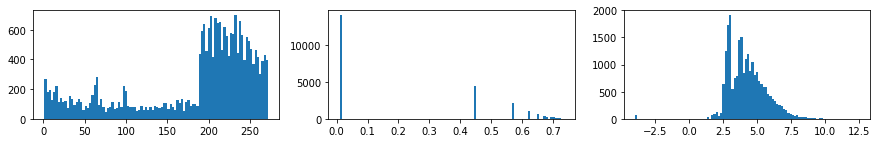

0


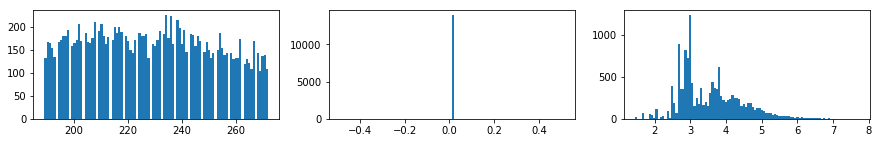

1


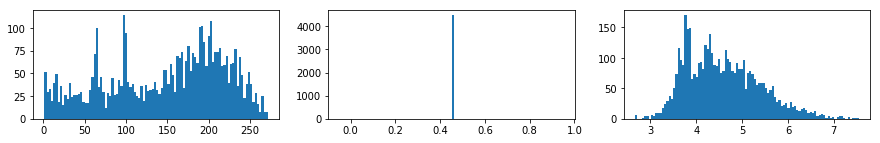

2


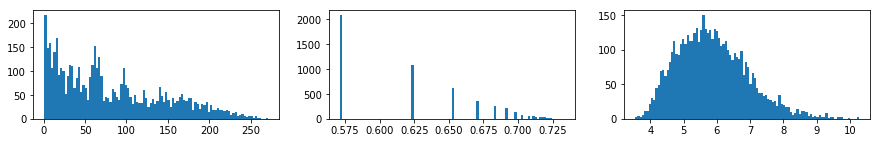

-1


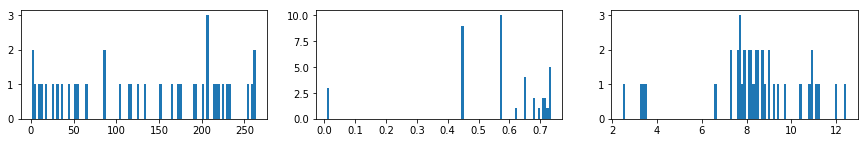

3


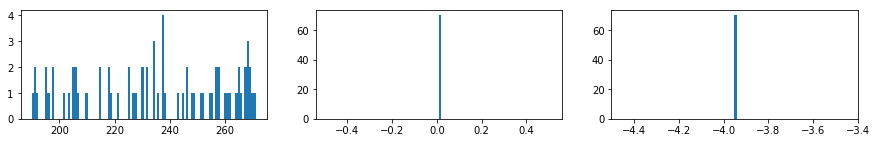

In [111]:
plt.figure(figsize=(15,2))
for i,col in enumerate(["recency","frequency","monetary"]):
    plt.subplot(1,3,i+1)
    plt.hist(rfm_o[col],bins=100);
plt.show()
for i in rfm_o["cluster"].unique():
    plt.figure(figsize=(15,2))
    print(i)
    for j,col in enumerate(["recency","frequency","monetary"]):
        plt.subplot(1,3,j+1)
        plt.hist(rfm_o[rfm_o["cluster"]==i][col],bins=100);
    plt.show()